# Exploratory Spatio-Temporal Data Analysis
# Data Inspection and Descriptive Statistics - Summary Statistics

## Load data

In [2]:
import numpy as np
import pandas as pd
import polars as pl

import matplotlib.pyplot as plt

import folium
from mpl_toolkits.basemap import Basemap

%matplotlib inline

In [3]:
import xarray as xr
import glob

def preprocess_dataset(ds: xr.Dataset) -> xr.Dataset:
    """
    Preprocess the dataset to ensure the `valid_time` coordinate is in `datetime64[ns]` format.

    Args:
        ds (xr.Dataset): Input dataset.

    Returns:
        xr.Dataset: Preprocessed dataset with `valid_time` converted to datetime.
    """
    if "valid_time" in ds.coords:
        ds["valid_time"] = ds["valid_time"].dt.floor("D")  # Truncate to date only
    return ds

# Define the directory containing your NetCDF files
data_dir = 'drought-forecasting/modeling-pipeline/data/01_raw/unzipped_files/ERA5_monthly_averaged_data_on_single_levels/'

# Create a sorted list of file paths
file_list = sorted(glob.glob(data_dir + '*.nc'))

# Open multiple files as a single dataset with preprocessing applied
ds = xr.open_mfdataset(
    file_list, 
    combine='by_coords', 
    preprocess=preprocess_dataset
)


In [4]:
ds

<xarray.Dataset> Size: 55GB
Dimensions:     (valid_time: 551, latitude: 721, longitude: 1440)
Coordinates:
    number      int64 8B 0
  * valid_time  (valid_time) datetime64[ns] 4kB 1979-01-01 ... 2024-11-01
  * latitude    (latitude) float64 6kB 90.0 89.75 89.5 ... -89.5 -89.75 -90.0
  * longitude   (longitude) float64 12kB 0.0 0.25 0.5 0.75 ... 359.2 359.5 359.8
    expver      (valid_time) <U4 9kB dask.array<chunksize=(551,), meta=np.ndarray>
Data variables: (12/24)
    cl          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    cvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tvh         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    asn         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    sst         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    slt         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ...          ...
    si10        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    e           (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    ro          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    tp          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    pev         (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
    swvl1       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(92, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

# NA Values 

In [5]:
# import xarray as xr

# # Check for missing values in each variable without compute
# missing_values = {var: ds[var].isnull().any().values for var in ds.data_vars}

# # Display the results
# for var, has_missing in missing_values.items():
#     print(f"Variable '{var}': {'Has missing values' if has_missing else 'No missing values'}")


# Fill NA values

In [6]:
import xarray as xr
from typing import List, Union

def fillna_in_variables(
    ds: xr.Dataset,
    variables: List[str],
    fill_value: Union[int, float]
) -> xr.Dataset:
    """
    Fills NaN values in specified variables of an xarray.Dataset with a provided value.

    Args:
        ds (xr.Dataset): The input dataset containing the data variables.
        variables (List[str]): A list of variable names in the dataset for which to fill NaN values.
        fill_value (Union[int, float]): The value to fill NaN values with (e.g., 0).

    Returns:
        xr.Dataset: A new dataset with NaN values filled in the specified variables.
    
    Example:
        ds = fillna_in_variables(ds, ["sst", "t2m"], fill_value=0)
    """
    # Check if each variable exists in the dataset
    for var in variables:
        if var not in ds:
            raise ValueError(f"Variable '{var}' not found in the dataset.")
    
    # Fill NaN values for the specified variables
    filled_ds = ds.copy()
    for var in variables:
        filled_ds[var] = filled_ds[var].fillna(fill_value)
    
    return filled_ds

In [7]:
ds = fillna_in_variables(ds, ["sst"], fill_value=0)

In [8]:
# import xarray as xr

# # Check for missing values in each variable without compute
# missing_values = {var: ds[var].isnull().any().values for var in ds.data_vars}

# # Display the results
# for var, has_missing in missing_values.items():
#     print(f"Variable '{var}': {'Has missing values' if has_missing else 'No missing values'}")


## Data Preprocessing and Feature Engineering 

In [9]:
import numpy as np
import xarray as xr

def interpolate_to_target_grid(ds, target_lat, target_lon, method="linear"):
    """
    Interpolates an xarray Dataset to a specified target latitude and longitude grid.
    
    Parameters:
        ds (xr.Dataset): The input dataset to be interpolated.
        target_lat (array-like): Target latitude values (e.g., np.arange(-90, 90, 1)).
        target_lon (array-like): Target longitude values (e.g., np.arange(0, 360, 1)).
        method (str): Interpolation method. Defaults to 'linear'.
                      Options include 'linear', 'nearest', etc.
    
    Returns:
        xr.Dataset: The interpolated dataset on the specified target grid.
    """
    # Step 1: Ensure latitude is in ascending order
    if ds.latitude[0] > ds.latitude[-1]:
        ds = ds.sortby("latitude")
    
    # Step 2: Perform interpolation
    interpolated_ds = ds.interp(latitude=target_lat, longitude=target_lon, method=method)
    
    return interpolated_ds

# Example usage
target_lat = np.arange(-90, 90, 1)   # 1° resolution latitude
target_lon = np.arange(0, 360, 1)   # 1° resolution longitude
method = "linear"

# ds = interpolate_to_target_grid(ds, target_lat, target_lon, method)

In [10]:
# Save the original attributes
original_attrs = ds['tp'].attrs

# Perform the conversion
ds['tp'] = ds['tp'] * 1000

# Restore the original attributes and update the units
ds['tp'].attrs = original_attrs
ds['tp'].attrs['units'] = 'mm'  # Update the units attribute to 'mm'

In [11]:
# Save the original attributes
original_attrs = ds['e'].attrs

# Perform the conversion
ds['e'] = ds['e'] * 1000

# Restore the original attributes and update the units
ds['e'].attrs = original_attrs
ds['e'].attrs['units'] = 'mm'  # Update the units attribute to 'mm'

In [12]:
# Save the original attributes
original_attrs = ds['pev'].attrs

# Perform the conversion
ds['pev'] = ds['pev'] * 1000

# Restore the original attributes and update the units
ds['pev'].attrs = original_attrs
ds['pev'].attrs['units'] = 'mm'  # Update the units attribute to 'mm'

In [13]:
# Update swvl1: Set to 1 wherever lsm indicates water (lsm == 1)
ds['swvl1'] = ds['swvl1'].where(ds['lsm'] != 0, other=1)

# Update pev: Set to 0 wherever lsm indicates water 
ds['pev'] = ds['pev'].where(ds['lsm'] != 0, other=0)

# Additional variables for deeper exploration

## Caluclate percent of mean 

In [14]:
import xarray as xr
import numpy as np
from typing import Tuple

def calculate_percent_of_normal(
    ds: xr.Dataset, 
    variable: str, 
    date_range: Tuple[str, str]
) -> xr.Dataset:
    """
    Generalized function to calculate Percent of Normal for a given variable.

    Args:
        ds (xr.Dataset): Input dataset containing the variable.
        variable (str): Variable name for which Percent of Normal is to be calculated.
        date_range (Tuple[str, str]): Climatology period as (start_date, end_date).

    Returns:
        xr.Dataset: Dataset with Percent of Normal added as a new variable.
    """
    # Ensure the variable exists
    if variable not in ds.variables:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")

    # Step 1: Filter dataset for the climatology period
    start_date, end_date = date_range
    ds_clim_period = ds.sel(valid_time=slice(start_date, end_date))

    # Step 2: Extract the variable and calculate monthly climatology mean
    data_clim_period = ds_clim_period[variable]
    climatology_mean = data_clim_period.groupby('valid_time.month').mean('valid_time')

    # Replace zeros and NaNs in climatology_mean with a small number
    climatology_mean = climatology_mean.where(climatology_mean > 0, other=1e-10).fillna(1e-10)

    # Step 3: Calculate Percent of Normal for all valid_time in the original dataset
    data_full = ds[variable]
    percent_of_normal = xr.apply_ufunc(
        lambda x, m: (x / m) * 100,
        data_full.groupby('valid_time.month'),
        climatology_mean,
        dask="allowed"
    )
    
    # Step 4: Add Percent of Normal to the original dataset
    ds_result = ds.copy()
    ds_result[f"{variable}_percent_of_normal"] = percent_of_normal

    return ds_result


In [15]:
date_range = ("1991-01-01", "2020-12-31")

# Assuming `ds` is your dataset
ds = calculate_percent_of_normal(ds, variable='tp', date_range=date_range)
ds = calculate_percent_of_normal(ds, variable='t2m', date_range=date_range)
ds = calculate_percent_of_normal(ds, variable='swvl1', date_range=date_range)

## Caluclate standardized monthly anomalies based on std 

In [16]:
import xarray as xr
import numpy as np
from typing import Tuple

def calculate_standardized_anomalies(
    ds: xr.Dataset, 
    variable: str, 
    date_range: Tuple[str, str]
) -> xr.Dataset:
    """
    Calculate standardized monthly anomalies for a specific variable,
    handling cases with zero standard deviation or NaNs.
    """
    # Ensure the variable exists
    if variable not in ds.variables:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")
    
    # Step 1: Filter dataset for the climatology period
    start_date, end_date = date_range
    ds_clim_period = ds.sel(valid_time=slice(start_date, end_date))
    
    # Step 2: Extract the variable and calculate monthly climatology (mean and std)
    data_clim_period = ds_clim_period[variable]
    climatology_mean = data_clim_period.groupby('valid_time.month').mean('valid_time')
    climatology_std = data_clim_period.groupby('valid_time.month').std('valid_time')

    # Replace zero standard deviation with a small number
    climatology_std = climatology_std.where(climatology_std > 0, other=1e-10)

    # Step 3: Calculate standardized anomalies for all valid_time in the original dataset
    data_full = ds[variable]
    standardized_anomalies = xr.apply_ufunc(
        lambda x, m, s: (x - m) / s,
        data_full.groupby('valid_time.month'),
        climatology_mean,
        climatology_std,
        dask="allowed"
    )

    # Step 4: Add standardized anomalies to the original dataset
    ds_standardized_anomalies = ds.copy()
    ds_standardized_anomalies[f"{variable}_std_anomaly"] = standardized_anomalies

    return ds_standardized_anomalies

In [17]:
date_range = ("1991-01-01", "2020-12-31")

ds = calculate_standardized_anomalies(ds, variable='tp', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='t2m', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='pev', date_range=date_range)
ds = calculate_standardized_anomalies(ds, variable='swvl1', date_range=date_range)

create land variables 

In [18]:
import xarray as xr

def create_land_variable(ds: xr.Dataset, variable: str, lsm_var: str = "lsm") -> xr.Dataset:
    """
    Create a land-only version of a specified variable using a land-sea mask (lsm).

    Args:
        ds (xr.Dataset): The input xarray dataset containing the variables.
        variable (str): The name of the variable to create the land-only version for.
        lsm_var (str): The name of the land-sea mask variable. Default is 'lsm'.

    Returns:
        xr.Dataset: A new dataset with the land-only version of the specified variable.

    Raises:
        ValueError: If the specified variable or land-sea mask is not present in the dataset.
    """
    if variable not in ds:
        raise ValueError(f"Variable '{variable}' not found in the dataset.")

    if lsm_var not in ds:
        raise ValueError(f"Land-sea mask variable '{lsm_var}' not found in the dataset.")

    # Ensure the land-sea mask is binary-like
    lsm = ds[lsm_var].where(ds[lsm_var] >= 0, other=0)

    # Mask the variable using the land-sea mask (threshold for land > 0.5)
    land_variable = ds[variable].where(lsm > 0.5)

    # Add the new variable to the dataset with a descriptive name
    land_var_name = f"{variable}_land_only"
    ds[land_var_name] = land_variable

    # Add metadata to the new variable
    ds[land_var_name].attrs.update({
        "description": f"Land-only version of {variable} based on {lsm_var}",
        "units": ds[variable].attrs.get("units", "unknown"),
        "land_only": True
    })

    return ds


In [19]:
# Example usage:
ds = create_land_variable(ds, "tp_std_anomaly")
ds = create_land_variable(ds, "t2m_std_anomaly")

ds = create_land_variable(ds, "tp_percent_of_normal")
ds = create_land_variable(ds, "t2m_percent_of_normal")


Mask downloaded from [Global Drought Crops Monitoring](https://global-drought-crops.csic.es/#map_name=all_spei_3#map_position=2205)

In [20]:
import xarray as xr
import os
import glob

# Define the preprocess function
def preprocess(file_path):
    """
    Preprocess a single dataset:
    - Load the dataset.
    - Extract the crop name from the file path.
    - Keep only the 'croparea' variable.
    - Rename 'croparea' to include the crop name.
    - Remove attributes to avoid conflicts.

    Args:
        file_path (str): Path to the NetCDF file.

    Returns:
        xarray.Dataset: Preprocessed dataset.
    """
    # Load the dataset
    ds = xr.open_dataset(file_path, chunks="auto")
    
    # Extract crop name from filename
    file_name = os.path.basename(file_path)
    crop_name = file_name.split("_")[-1].split(".")[0]  # Extracts 'carrot'

    # Keep only 'croparea' and rename it
    ds = ds[['croparea']].rename_vars({'croparea': f'{crop_name}_croparea'})

    # Remove conflicting attributes
    ds.attrs = {}
    return ds

# Define the directory containing your NetCDF files
data_dir = '/teamspace/studios/this_studio/drought-forecasting/modeling-pipeline/data/01_raw/unzipped_files/CROPGRIDS/CROPGRIDSv1.08_NC_maps/CROPGRIDSv1.08_NC_maps/'

# Create a sorted list of file paths
file_list = sorted(glob.glob(data_dir + '*.nc'))

# Exclude specific file
excluded_file = 'Countries_2018.nc'
file_list = [file for file in file_list if not file.endswith(excluded_file)]

# Preprocess each file and combine them
datasets = [preprocess(file_path) for file_path in file_list]
crop_ds = xr.combine_by_coords(datasets, combine_attrs="override")

# Apply mask: Set values below 100 to 0, and values equal to or above 100 to 1
crop_ds = crop_ds.map(lambda da: xr.where(da >= 1, 1, 0))

# Step 1: Adjust longitude for crop_ds
crop_ds = crop_ds.assign_coords(lon=((crop_ds.lon + 360) % 360)).sortby('lon')

In [21]:
crop_ds

<xarray.Dataset> Size: 36GB
Dimensions:                  (lat: 3600, lon: 7200)
Coordinates:
  * lat                      (lat) float32 14kB -89.97 -89.93 ... 89.93 89.97
  * lon                      (lon) float32 29kB 0.02499 0.07501 ... 359.9 360.0
Data variables: (12/173)
    abaca_croparea           (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    agave_croparea           (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    alfalfa_croparea         (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    almond_croparea          (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    aniseetc_croparea        (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    apple_croparea           (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    ...                       ...
    vetch_croparea           (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    walnut_croparea          (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    watermelon_croparea      (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    wheat_croparea           (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    yam_croparea             (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>
    yautia_croparea          (lat, lon) int64 207MB dask.array<chunksize=(3600, 7200), meta=np.ndarray>

In [22]:
import xarray as xr

def mask_with_crop_area(ds: xr.Dataset, crop_ds: xr.Dataset, variable: str, crop: str) -> xr.Dataset:
    """
    Interpolates `crop_ds` to match `ds` using Dask, then masks a variable in `ds` with a crop area from `crop_ds`.
    Creates a new variable in `ds` with the masked values.

    Args:
        ds (xr.Dataset): Dataset containing the variable to mask.
        crop_ds (xr.Dataset): Dataset containing crop area variables.
        variable (str): Name of the variable in `ds` to mask.
        crop (str): Specific crop variable to use for masking (e.g., 'cotton_croparea').

    Returns:
        xr.Dataset: Dataset with a new variable containing the masked values.

    Raises:
        ValueError: If the specified variable or crop is not found in the datasets.
    """
    if variable not in ds:
        raise ValueError(f"Variable '{variable}' not found in the dataset `ds`.")

    # Unify chunks for consistent Dask operations
    ds = ds.unify_chunks()
    crop_ds = crop_ds.unify_chunks()

    # Check if the specific crop is in the crop dataset
    if crop not in crop_ds:
        raise ValueError(f"Crop variable '{crop}' not found in the dataset `crop_ds`.")

    # Use the specific crop area as the mask
    mask = crop_ds[crop]

    # Interpolate crop mask to match `ds` spatial resolution using Dask
    interpolated_mask = mask.interp(
        lat=ds.latitude, lon=ds.longitude, method="nearest"
    )

    # Mask the variable
    masked_variable = ds[variable].where(interpolated_mask > 0)

    # Add the masked variable as a new variable in the dataset
    masked_variable_name = f"{variable}_{crop}"
    ds[masked_variable_name] = masked_variable

    return ds


In [24]:
# Apply mask for specific crop
ds = mask_with_crop_area(ds, crop_ds, "tp_percent_of_normal", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "tp_std_anomaly", crop="barley_croparea")

ds = mask_with_crop_area(ds, crop_ds, "t2m", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "t2m_percent_of_normal", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "t2m_std_anomaly", crop="barley_croparea")

ds = mask_with_crop_area(ds, crop_ds, "pev", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "pev_std_anomaly", crop="barley_croparea")

ds = mask_with_crop_area(ds, crop_ds, "swvl1", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "swvl1_percent_of_normal", crop="barley_croparea")
ds = mask_with_crop_area(ds, crop_ds, "swvl1_std_anomaly", crop="barley_croparea")

In [25]:
ds

<xarray.Dataset> Size: 103GB
Dimensions:                                  (valid_time: 551, latitude: 721,
                                              longitude: 1440)
Coordinates:
    number                                   int64 8B 0
  * valid_time                               (valid_time) datetime64[ns] 4kB ...
  * latitude                                 (latitude) float64 6kB 90.0 ... ...
  * longitude                                (longitude) float64 12kB 0.0 ......
    expver                                   (valid_time) <U4 9kB dask.array<chunksize=(45,), meta=np.ndarray>
    month                                    (valid_time) int64 4kB 1 2 ... 11
    lat                                      (latitude) float64 6kB 90.0 ... ...
    lon                                      (longitude) float64 12kB 0.0 ......
Data variables: (12/45)
    cl                                       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    cvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    asn                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    sst                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    slt                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    ...                                       ...
    t2m_std_anomaly_barley_croparea          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_barley_croparea                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_barley_croparea          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_barley_croparea                    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_barley_croparea  (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_barley_croparea        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

## Data Inspection

SKUPIMY SIE NA     date='2022-11-01',





Ethiopia 

Seasons
- Bega is the dry season from December to January.
- Belg is a short rainy season in most parts of Ethiopia. From March to May, rainfall is highly variable and high maximum temperatures are common. 
- Kiremt is the rainy season when 85% to 95% of food crops are produced.Covering from June to August.
Source: [Seasons of Ethiopia](https://en.wikipedia.org/wiki/Seasons_of_Ethiopia)

Droughts:
- 2011 East Africa Drought: In 2011, the rains were late, falling in late April and May, and inadequate 

- 2020–2023 Horn of Africa Drought: During the 2020–2023 Horn of Africa drought, the 2022 rainy season was recorded as the driest in over 40 years, leading to severe water and food shortages in the region. 
Source: [Horn of Africa drought (2020–2023)](https://en.wikipedia.org/wiki/Horn_of_Africa_drought_(2020%E2%80%932023))

Coutries for further exploration 
- China 
- India 
- Indonesia 
- Pakistan 
- Nigeria
- Brazil
- Bangladesh 




### Area of intrest

#### Snapshots 

In [26]:
ds

<xarray.Dataset> Size: 103GB
Dimensions:                                  (valid_time: 551, latitude: 721,
                                              longitude: 1440)
Coordinates:
    number                                   int64 8B 0
  * valid_time                               (valid_time) datetime64[ns] 4kB ...
  * latitude                                 (latitude) float64 6kB 90.0 ... ...
  * longitude                                (longitude) float64 12kB 0.0 ......
    expver                                   (valid_time) <U4 9kB dask.array<chunksize=(45,), meta=np.ndarray>
    month                                    (valid_time) int64 4kB 1 2 ... 11
    lat                                      (latitude) float64 6kB 90.0 ... ...
    lon                                      (longitude) float64 12kB 0.0 ......
Data variables: (12/45)
    cl                                       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    cvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    asn                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    sst                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    slt                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    ...                                       ...
    t2m_std_anomaly_barley_croparea          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_barley_croparea                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_barley_croparea          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_barley_croparea                    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_barley_croparea  (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_barley_croparea        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts

In [64]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import cartopy.feature as cfeature

def plot_variable_snapshot(
    ds: xr.Dataset,
    variable: str,
    date: str,
    figsize: tuple = (20, 12),
    cbar_label: str = 'Value',
    title: str = None,
    cmap: str = None,
    vmin: float = None,
    vmax: float = None,
    show_countries: bool = False
) -> None:
    """
    Plots a snapshot of a specified variable from an xarray Dataset for a given date using custom or specified colormaps.
    The longitude is shifted so that 0 degrees is at the center of the plot. Optionally overlays country boundaries.

    Args:
        ds (xarray.Dataset): The xarray Dataset containing the data.
        variable (str): The variable name in the dataset to plot (e.g., 'swvl1', 't2m', 'cl').
        date (str): The date for which to plot the snapshot in 'YYYY-MM-DD' format.
        figsize (tuple, optional): Size of the plot in inches. Defaults to (20, 12).
        cbar_label (str, optional): Label for the colorbar. Defaults to 'Value'.
        title (str, optional): Title of the plot. If not provided, a default title based on the variable and date will be used.
        cmap (str, optional): Colormap name to use for the plot (e.g., 'viridis', 'plasma'). 
                              If not specified, a custom colormap is used for 'swvl1', 
                              and 'viridis' is used for other variables.
        vmin (float, optional): Minimum value for color scale. Defaults to None, which uses data-specific minimum.
        vmax (float, optional): Maximum value for color scale. Defaults to None, which uses data-specific maximum.
        show_countries (bool, optional): Whether to overlay country boundaries. Defaults to False.

    Returns:
        None: Displays the plot.
    """
    # Validate if the variable exists in the dataset
    if variable not in ds.data_vars:
        raise ValueError(
            f"Variable '{variable}' not found in the dataset. "
            f"Available variables are: {list(ds.data_vars.keys())}"
        )

    # Define custom boundaries and colors for specific variables
    # if variable == 'swvl1' and cmap is None:
    if (variable == 'swvl1' or variable == 'swvl1_barley_croparea') and cmap is None:
        # boundaries = [0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]  # Meaningful soil moisture ranges
        # colors = ['red', 'orange', 'green', 'green', 'lightblue', 'blue']  # Critical to excessive moisture
        boundaries = [0.0, 0.05, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7]
        colors = ['darkred', 'red', 'orange', 'yellow', 'green', 'green', 'lightblue', 'blue', 'darkblue']
        cmap_obj = mcolors.ListedColormap(colors)
        norm = mcolors.BoundaryNorm(boundaries, cmap_obj.N)
    else:
        # Use specified colormap or default 'viridis' for other variables
        cmap_name = cmap if cmap is not None else 'viridis'
        cmap_obj = plt.get_cmap(cmap_name)

        # Use provided vmin and vmax or fall back to dataset-specific min and max
        if vmin is None:
            vmin = ds[variable].min().item()
        if vmax is None:
            vmax = ds[variable].max().item()
        norm = mcolors.Normalize(vmin=vmin, vmax=vmax)

    # Select the data slice for the specified variable and date
    try:
        data_snapshot = ds[variable].sel(valid_time=date)
    except KeyError as e:
        raise KeyError(
            f"Date '{date}' not found in 'valid_time' coordinate."
        ) from e

    # Shift longitude from [0, 360) to [-180, 180)
    data_snapshot = data_snapshot.assign_coords(
        longitude=(((data_snapshot.longitude + 180) % 360) - 180)
    ).sortby('longitude')

    # Initialize the plot with PlateCarree projection
    fig, ax = plt.subplots(figsize=figsize, subplot_kw={'projection': ccrs.PlateCarree()})
    
    # Plot the data with the custom or specified/default colormap and normalization
    data_snapshot.plot(
        ax=ax,
        cmap=cmap_obj,
        norm=norm,
        cbar_kwargs={'label': cbar_label},
        transform=ccrs.PlateCarree()
    )

    # Overlay country boundaries if requested
    if show_countries:
        ax.add_feature(cfeature.BORDERS, linewidth=1, edgecolor='black')  # Country borders
        ax.add_feature(cfeature.COASTLINE, linewidth=1, edgecolor='black')  # Coastlines
    
    # Set the plot title
    if title is None:
        # Attempt to use the 'long_name' attribute; fallback to variable name
        long_name = ds[variable].attrs.get('long_name', variable)
        title = f'{long_name} on {date}'
    ax.set_title(title)

    # Improve layout and display the plot
    plt.tight_layout()
    plt.show()


##### Total precipitation

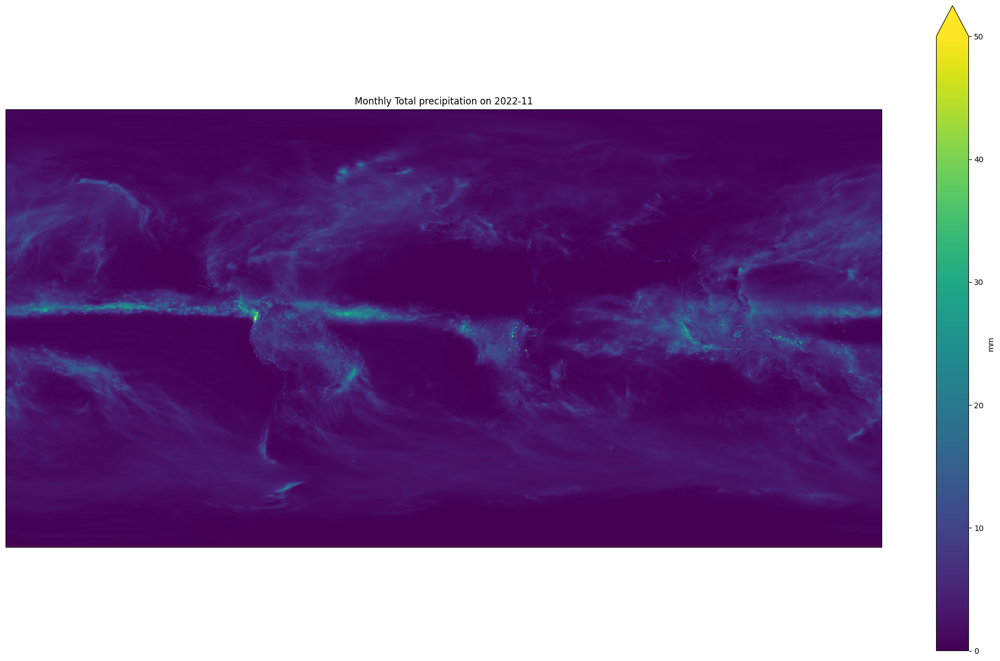

In [38]:
plot_variable_snapshot(
    ds=ds,
    variable='tp',
    date='2022-11-01',
    cbar_label='mm',
    title = 'Monthly Total precipitation on 2022-11',
    cmap='viridis',
    vmin=0.0,
    vmax=50,
)

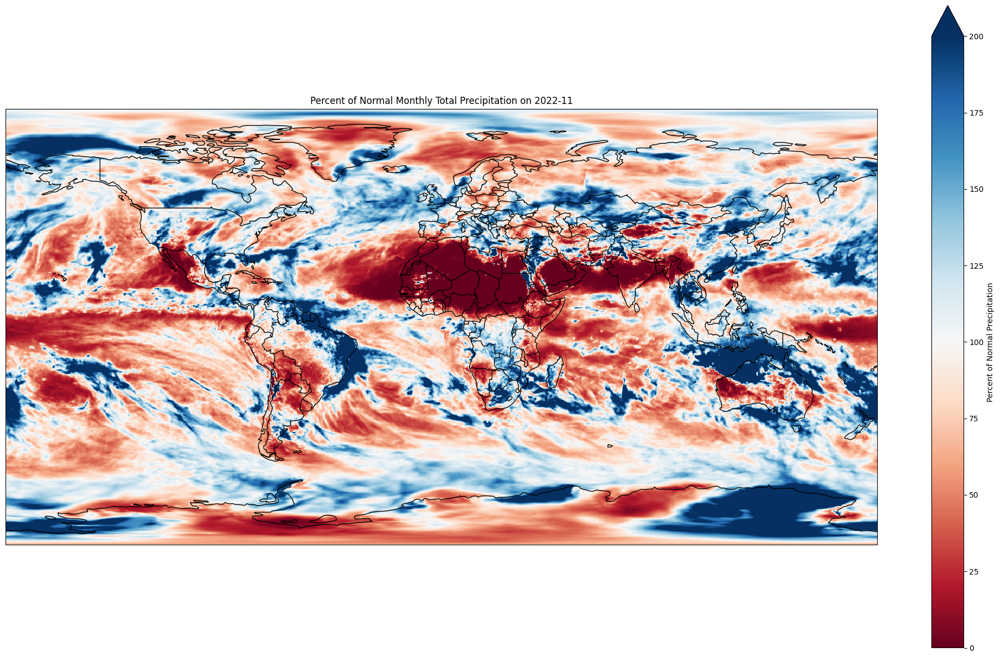

In [39]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    title = 'Percent of Normal Monthly Total Precipitation on 2022-11',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

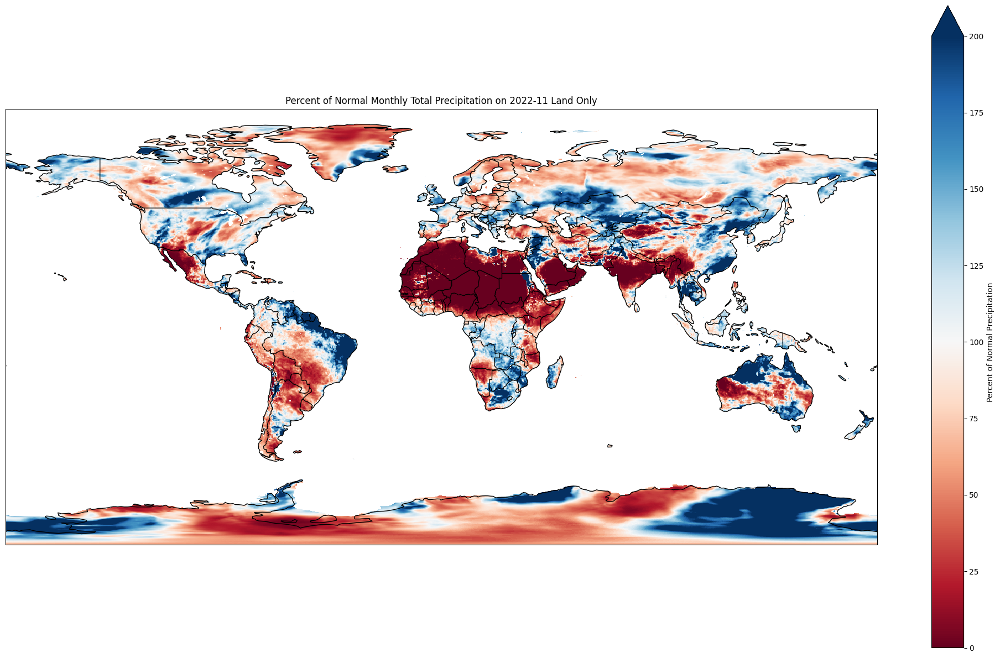

In [44]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_percent_of_normal_land_only',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    title = 'Percent of Normal Monthly Total Precipitation on 2022-11 Land Only',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

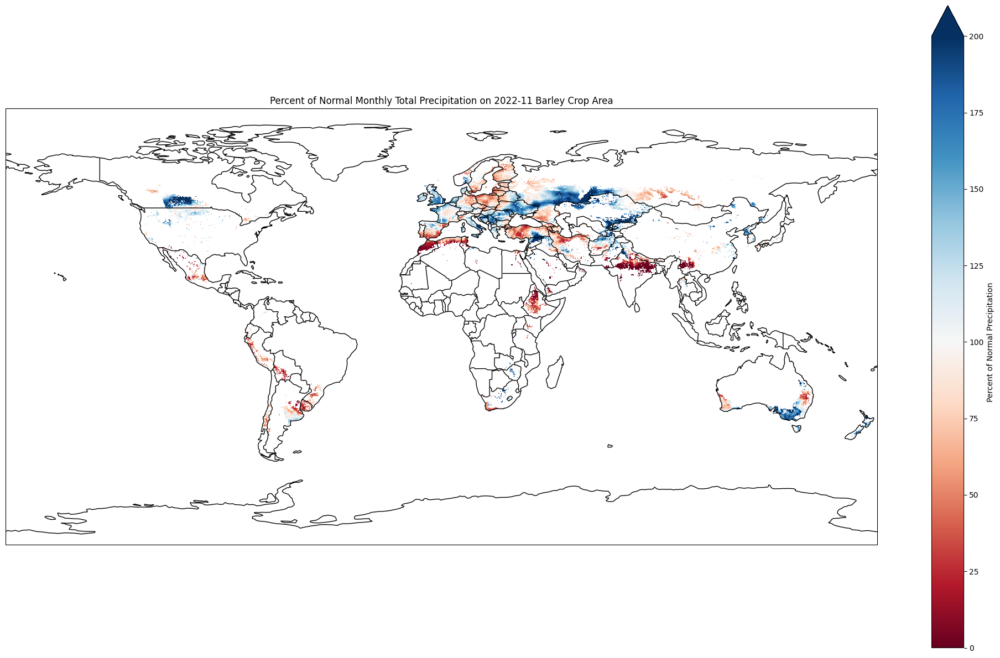

In [41]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_percent_of_normal_barley_croparea',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    title = 'Percent of Normal Monthly Total Precipitation on 2022-11 Barley Crop Area',
    cmap='RdBu',
    vmin=0,
    vmax=200,
    show_countries=True
)

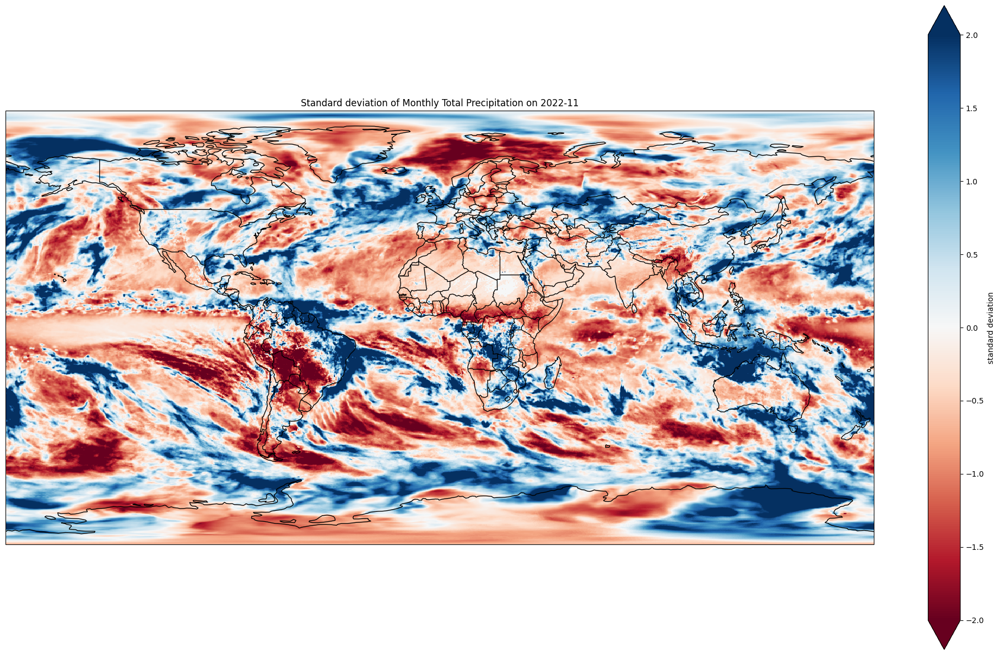

In [55]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_std_anomaly',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviation of Monthly Total Precipitation on 2022-11',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

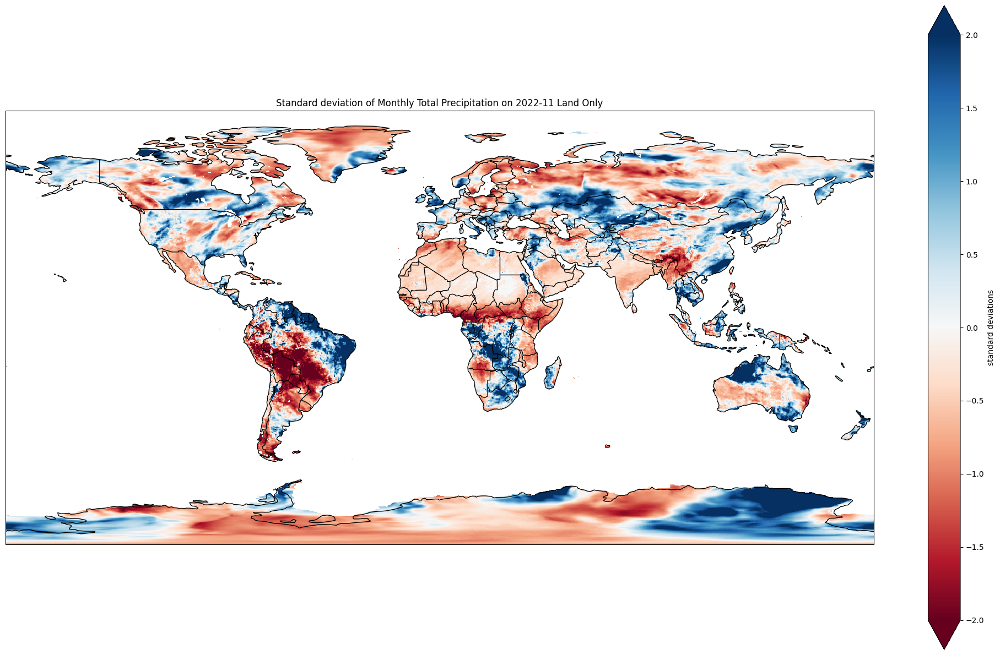

In [43]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_std_anomaly_land_only',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviation of Monthly Total Precipitation on 2022-11 Land Only',
    cmap='RdBu',
    vmin=-2.0,
    vmax=2.0,
    show_countries=True
)

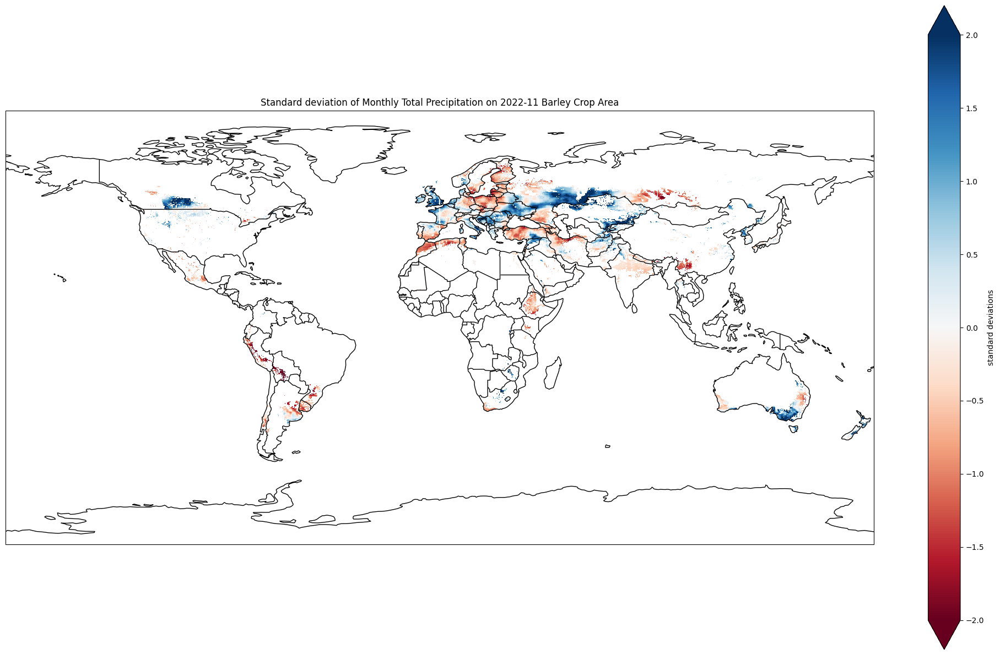

In [45]:
plot_variable_snapshot(
    ds=ds,
    variable='tp_std_anomaly_barley_croparea',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviation of Monthly Total Precipitation on 2022-11 Barley Crop Area',
    cmap='RdBu',
    vmin=-2.0,
    vmax=2.0,
    show_countries=True
)

##### 2 Metre Temperature

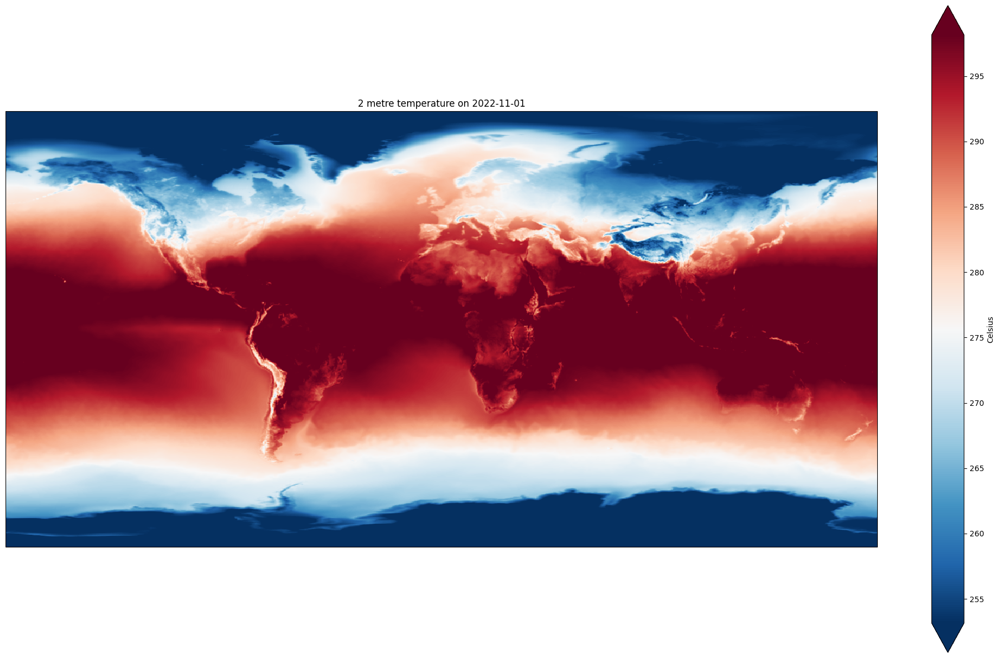

In [68]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m',
    date='2022-11-01',
    cbar_label='Celsius',
    cmap='RdBu_r',
    vmin=-20 + 273.15,
    vmax=25 + 273.15,
)

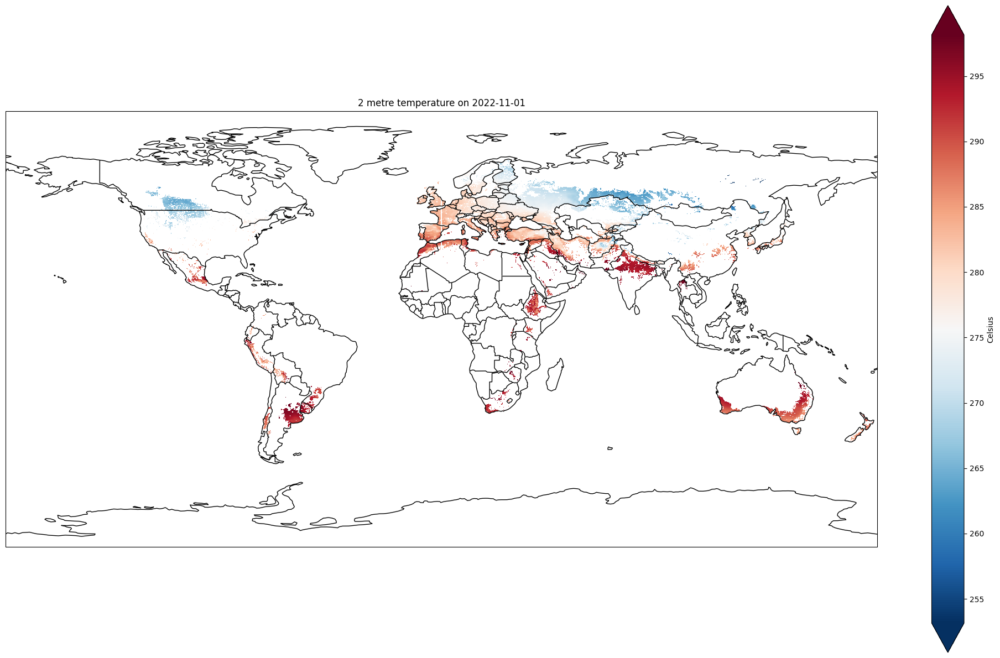

In [69]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_barley_croparea',
    date='2022-11-01',
    cbar_label='Celsius',
    cmap='RdBu_r',
    vmin=-20 + 273.15,
    vmax=25 +273.15,
    show_countries=True
)

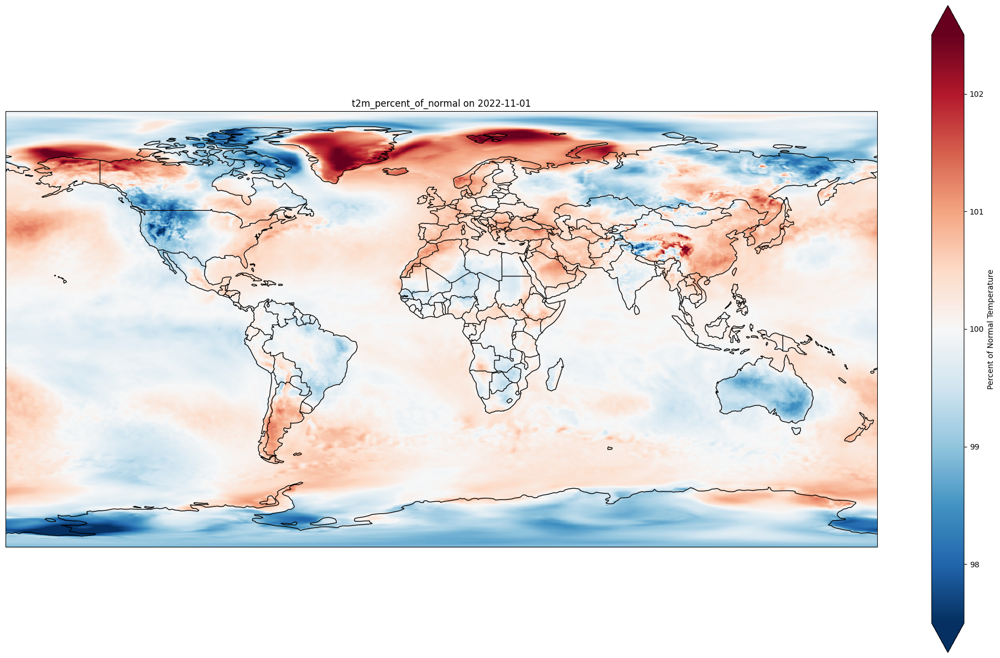

In [159]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Temperature',
    cmap='RdBu_r',
    vmin=97.5,
    vmax=102.5,
    show_countries=True
)

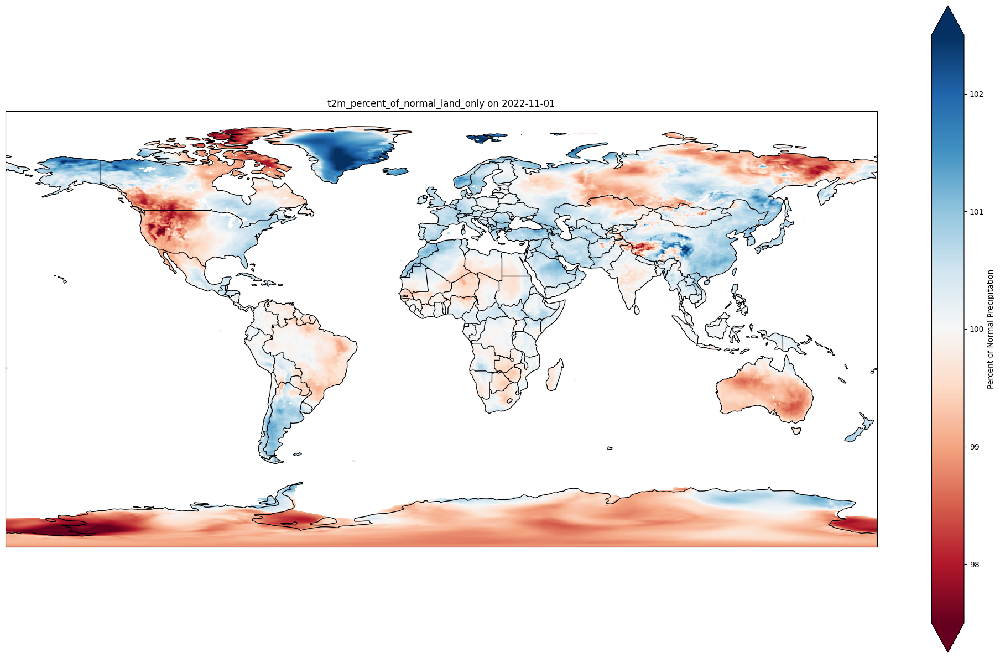

In [27]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_percent_of_normal_land_only',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu',
    vmin=97.5,
    vmax=102.5,
    show_countries=True
)

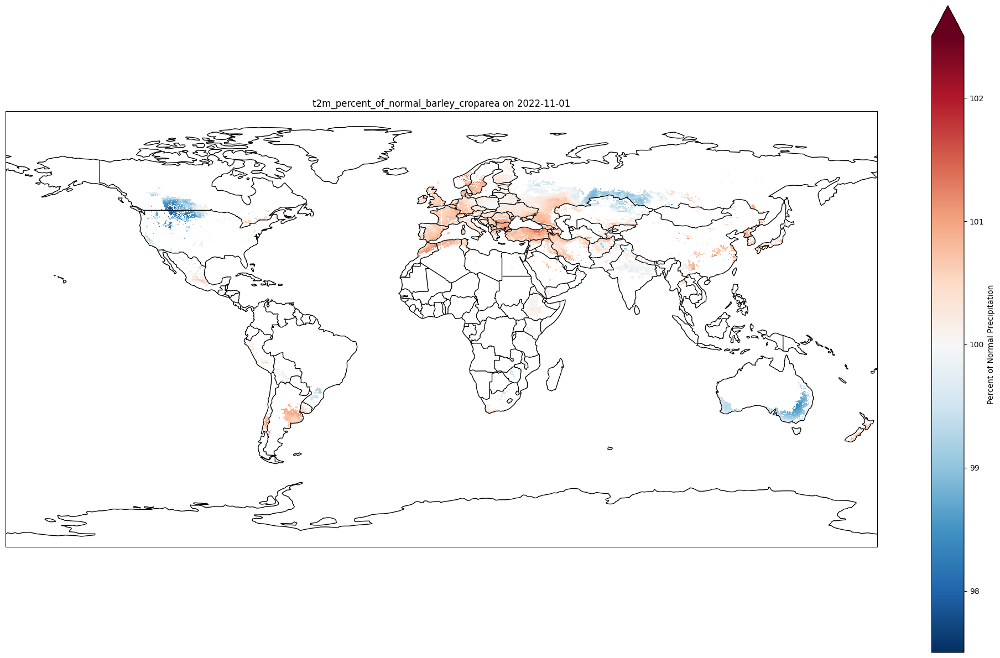

In [83]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_percent_of_normal_barley_croparea',
    date='2022-11-01',
    cbar_label='Percent of Normal Precipitation',
    cmap='RdBu_r',
    vmin=97.5,
    vmax=102.5,
    show_countries=True
)

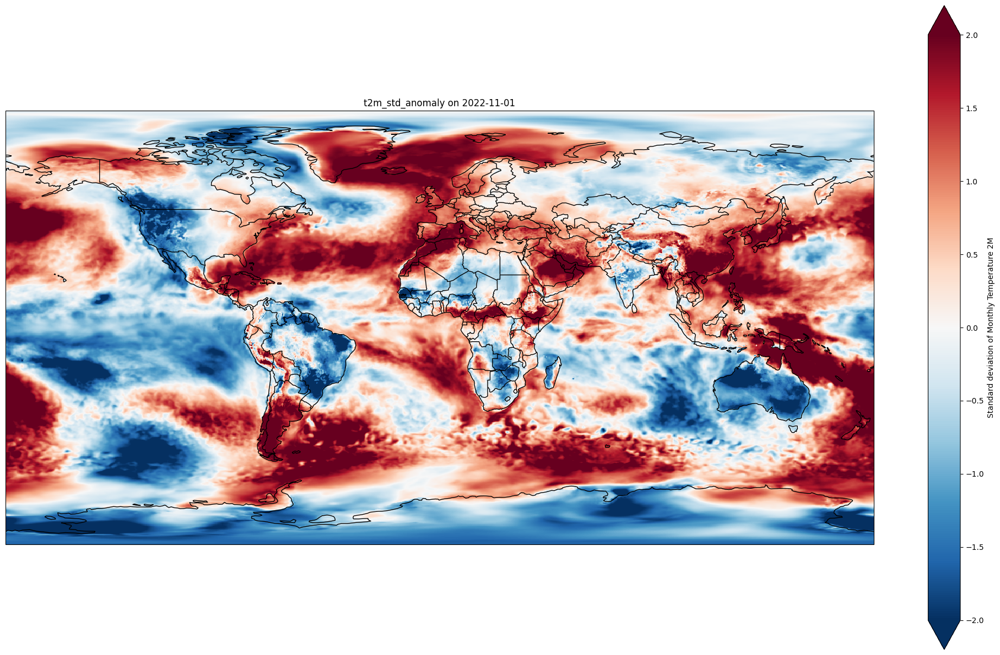

In [84]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_std_anomaly',
    date='2022-11-01',
    cbar_label='Standard deviation of Monthly Temperature 2M',
    cmap='RdBu_r',
    vmin=-2,
    vmax=2,
    show_countries=True
)

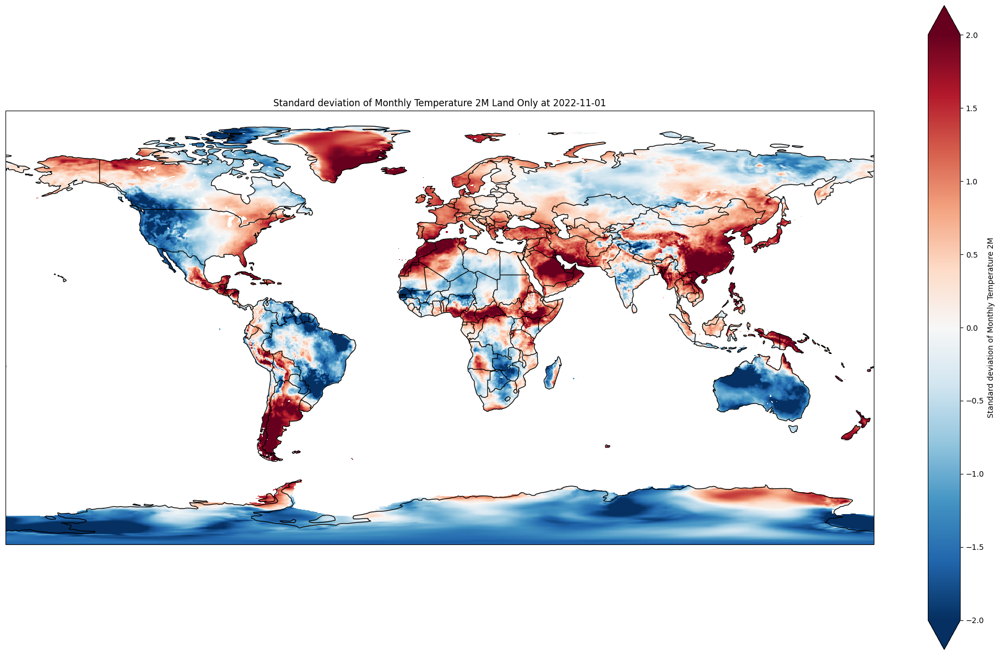

In [87]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_std_anomaly_land_only',
    date='2022-11-01',
    cbar_label='Standard deviation of Monthly Temperature 2M',
    title='Standard deviation of Monthly Temperature 2M Land Only at 2022-11-01',
    cmap='RdBu_r',
    vmin=-2.0,
    vmax=2.0,
    show_countries=True
)

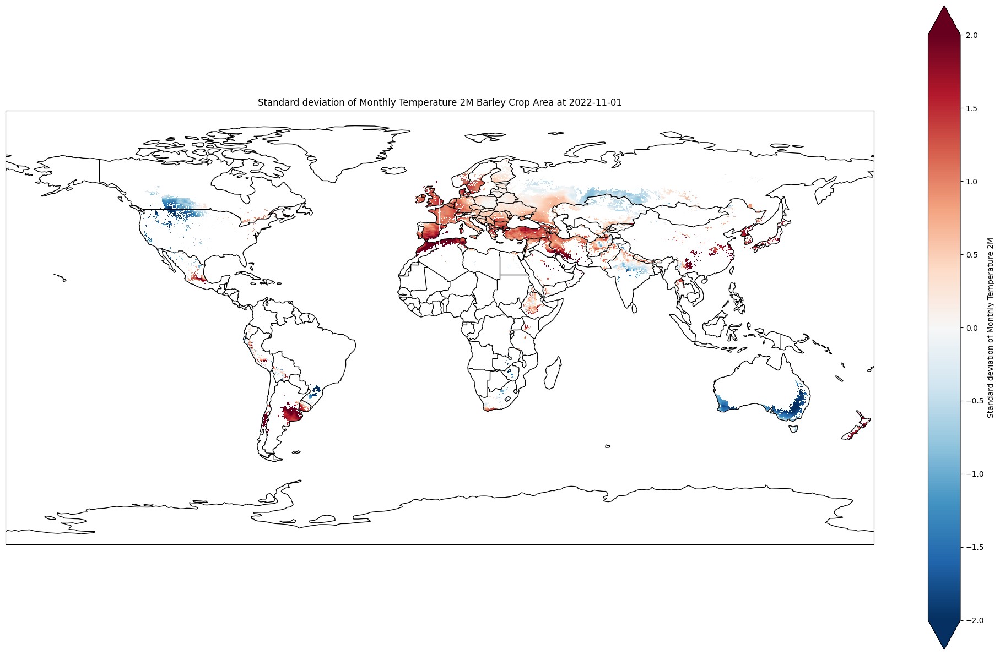

In [92]:
plot_variable_snapshot(
    ds=ds,
    variable='t2m_std_anomaly_barley_croparea',
    date='2022-11-01',
    cbar_label='Standard deviation of Monthly Temperature 2M',
    title='Standard deviation of Monthly Temperature 2M Barley Crop Area at 2022-11-01',
    cmap='RdBu_r',
    vmin=-2.0,
    vmax=2.0,
    show_countries=True
)

In [ ]:
vmin = ds['pev'].min().compute().item()
# vmax = ds['pev'].max().compute().item()

# vmin, vmax
# (-15.054546356201172, 1.2273974418640137)

Levels of Potential Evapotranspiration (PET) in an Agricultural Context

- Low PET: Less than 2 mm/day.
- Moderate PET: Between 3–6 mm/day.
- High PET: Between 7–10 mm/day.
- Extreme PET: Greater than 10 mm/day.

In [ ]:
plot_variable_snapshot(
    ds=ds,
    variable='pev',
    date='2011-04-01',
    cbar_label='mm of water equivalent',
    title='Monthly Evaporation on 2011-04-01',
    cmap='Reds_r',
    vmin=-10,
    vmax=-4,
    show_countries=True
)

In [ ]:
plot_variable_snapshot(
    ds=ds,
    variable='pev',
    date='2011-04-01',
    cbar_label='mm of water equivalent',
    title='Monthly Evaporation on 2011-04-01',
    cmap='Reds_r',
    vmin=-10,
    vmax=-4,
    show_countries=True
)

In [ ]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_barley_croparea',
    date='2011-04-01',
    cbar_label='mm of water equivalent',
    title='Monthly Potential evaporation on 2011-04-01 Barley Crop Area',
    cmap='Reds_r',
    vmin=-10,
    vmax=-4, 
    show_countries=True
)

In [ ]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviations of Monthly Potential evaporation on 2022-11',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

In [ ]:
plot_variable_snapshot(
    ds=ds,
    variable='pev_std_anomaly_barley_croparea',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviations of Monthly Potential evaporation on 2022-11 Barley Crop Area',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

##### Volumetric Soil Water Layer 1

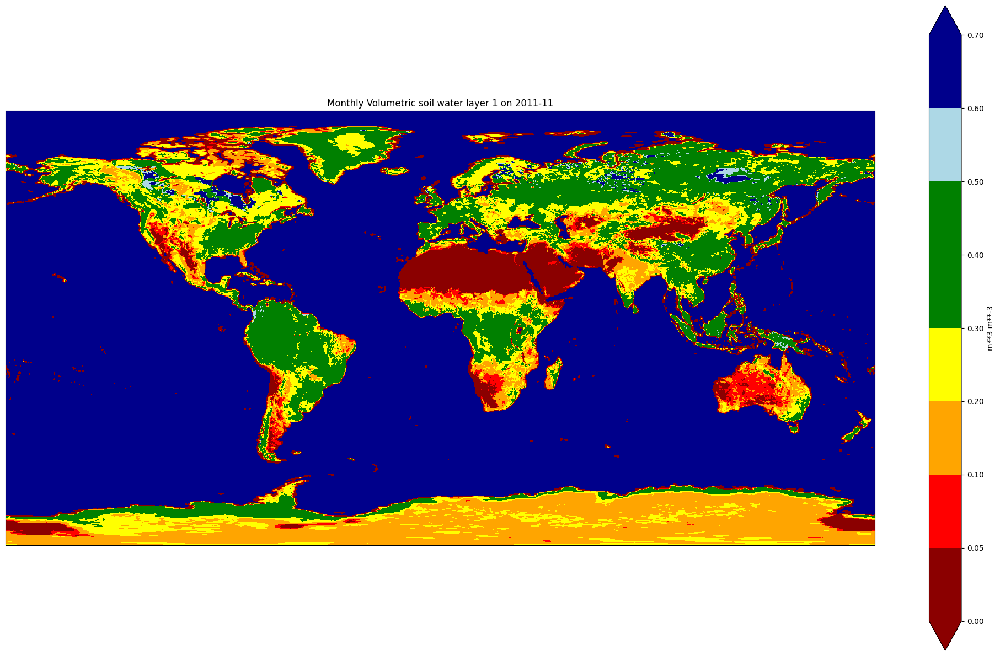

In [66]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1',
    date='2011-11-01',
    cbar_label='m**3 m**-3',
    title='Monthly Volumetric soil water layer 1 on 2011-11'
)

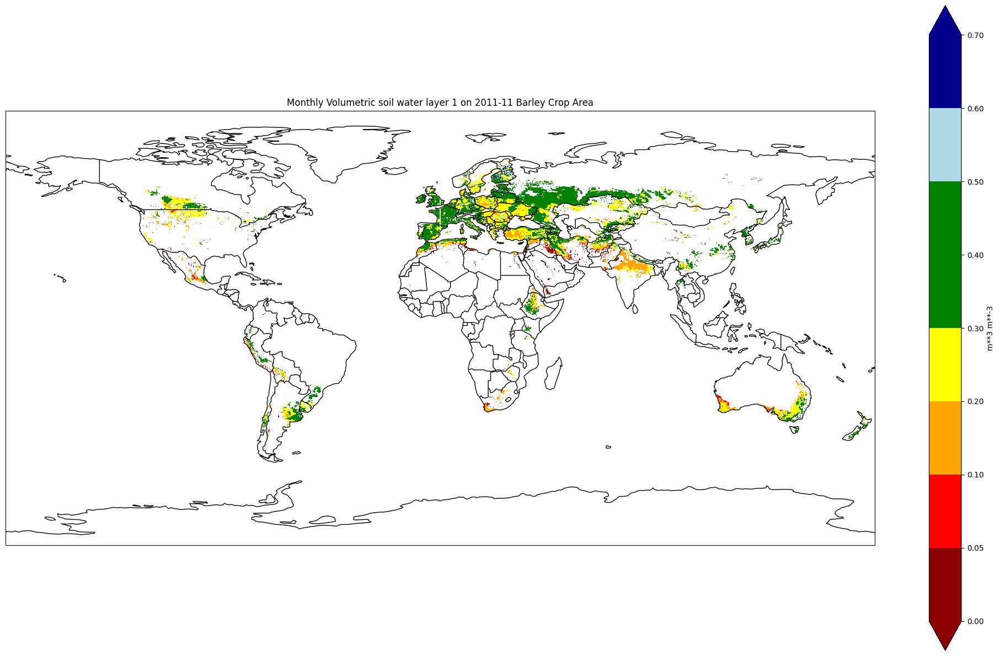

In [67]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_barley_croparea',
    date='2011-11-01',
    cbar_label='m**3 m**-3',
    title='Monthly Volumetric soil water layer 1 on 2011-11 Barley Crop Area',
    show_countries=True
)

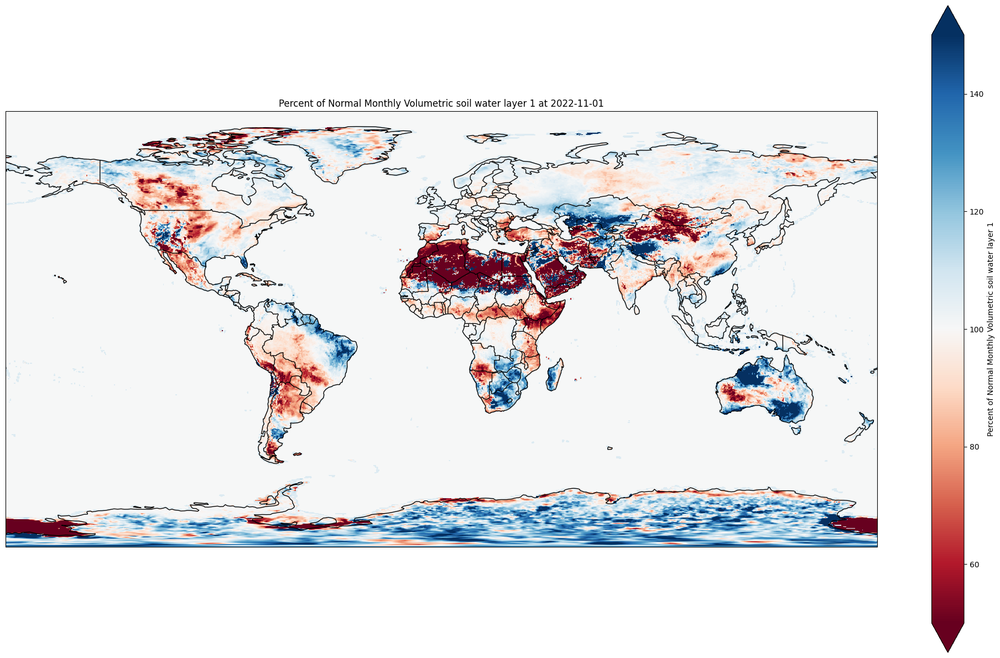

In [68]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_percent_of_normal',
    date='2022-11-01',
    cbar_label='Percent of Normal Monthly Volumetric soil water layer 1',
    title='Percent of Normal Monthly Volumetric soil water layer 1 at 2022-11-01',
    cmap='RdBu',
    vmin=50,
    vmax=150,
    show_countries=True
)

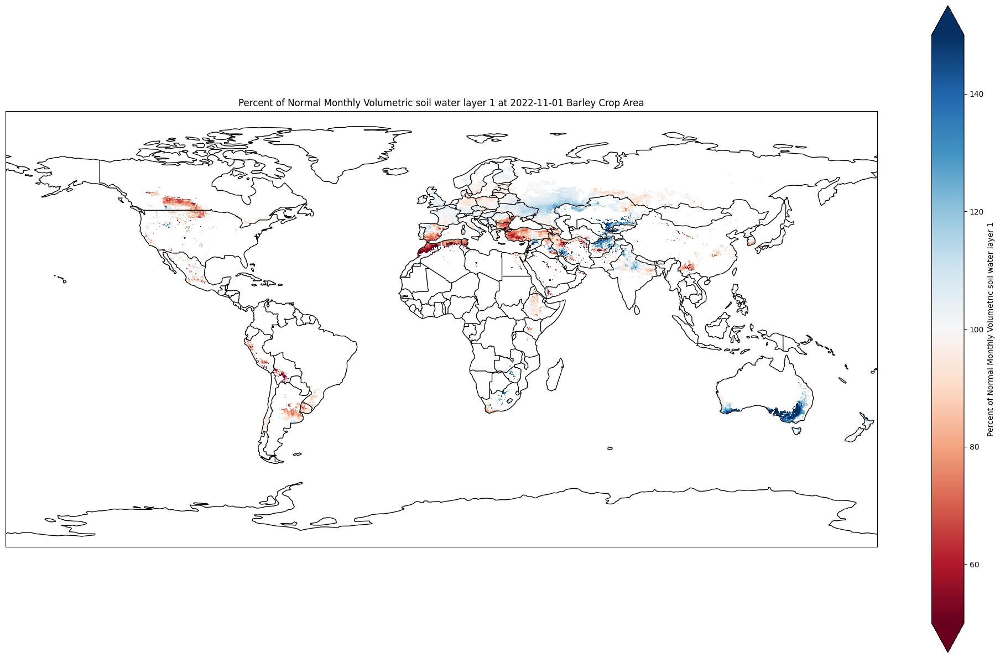

In [69]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_percent_of_normal_barley_croparea',
    date='2022-11-01',
    cbar_label='Percent of Normal Monthly Volumetric soil water layer 1',
    title='Percent of Normal Monthly Volumetric soil water layer 1 at 2022-11-01 Barley Crop Area',
    cmap='RdBu',
    vmin=50,
    vmax=150,
    show_countries=True
)

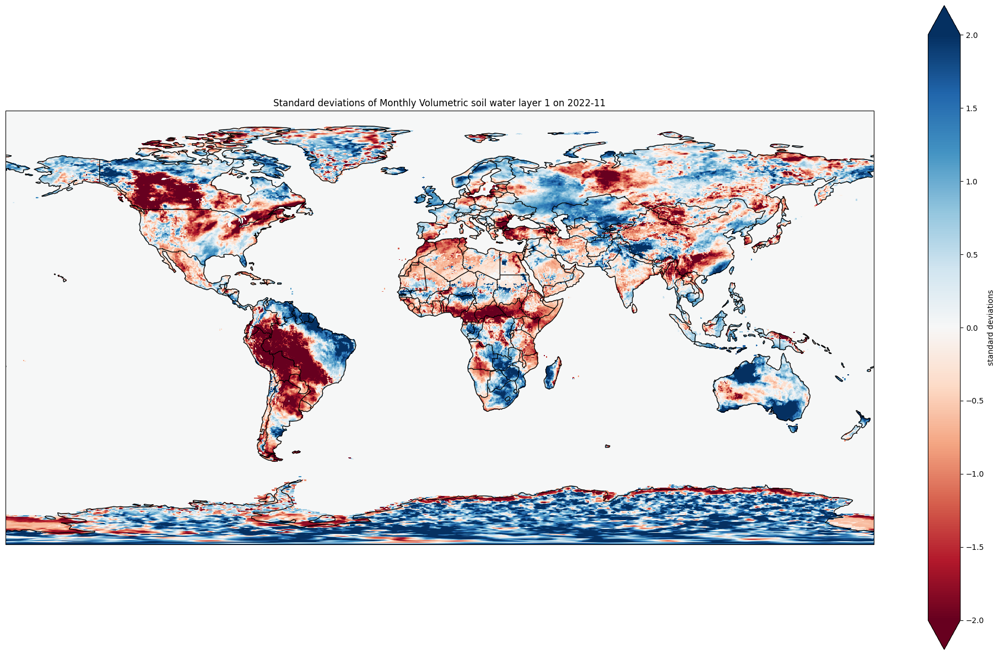

In [58]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviations of Monthly Volumetric soil water layer 1 on 2022-11',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

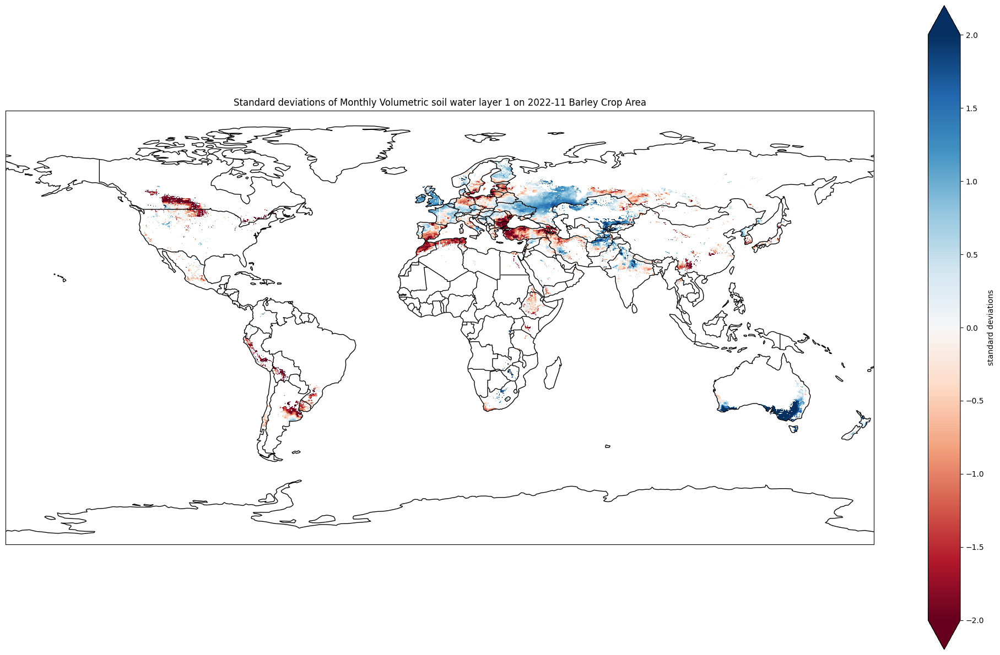

In [71]:
plot_variable_snapshot(
    ds=ds,
    variable='swvl1_std_anomaly_barley_croparea',
    date='2022-11-01',
    cbar_label='standard deviations',
    title = 'Standard deviations of Monthly Volumetric soil water layer 1 on 2022-11 Barley Crop Area',
    cmap='RdBu',
    vmin=-2,
    vmax=2,
    show_countries=True
)

#### Whole range of dates

In [35]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import xarray as xr
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from typing import Optional

import dask.array as da

def visualize_variable_on_map(
    dataset: xr.Dataset,
    variable: str,
    time_dim: str = 'valid_time',
    lat_dim: str = 'latitude',
    lon_dim: str = 'longitude',
    plot_type: str = 'scatter_geo',
    downsample_factor: Optional[int] = 1,
    projection: str = 'natural earth',
    color_scale: Optional[list] = None,
    custom_boundaries: Optional[list] = None,
    title: Optional[str] = None,
    animation_frame: Optional[str] = None,
    hover_precision: int = 2,
    custom_colorbar_title: Optional[str] = None,
    start_date: Optional[str] = None,
    end_date: Optional[str] = None,
    vmin: Optional[float] = None,
    vmax: Optional[float] = None,
    **kwargs
) -> go.Figure:
    """
    Modified function to visualize variables in xarray.Dataset with dask support.
    """
    grib_name = dataset[variable].attrs.get("GRIB_name", variable)
    grib_units = dataset[variable].attrs.get("GRIB_units", "")
    if not title:
        title = f"{grib_name}"
        if start_date or end_date:
            title += f" ({start_date or ''} to {end_date or ''})"
    colorbar_title = custom_colorbar_title if custom_colorbar_title else grib_units

    da = dataset[variable]

    for dim in [time_dim, lat_dim, lon_dim]:
        if dim not in da.dims:
            raise ValueError(f"Dimension '{dim}' not found in variable '{variable}'.")

    if start_date or end_date:
        if start_date:
            da = da.sel({time_dim: da[time_dim] >= pd.to_datetime(start_date)})
        if end_date:
            da = da.sel({time_dim: da[time_dim] <= pd.to_datetime(end_date)})

    if downsample_factor > 1:
        da = da.coarsen({lat_dim: downsample_factor, lon_dim: downsample_factor}, boundary='trim').mean()

    if custom_boundaries and color_scale:
        boundaries = custom_boundaries
        cmap = mcolors.ListedColormap(color_scale)
        norm = mcolors.BoundaryNorm(boundaries, cmap.N)
        color_min, color_max = boundaries[0], boundaries[-1]
    else:
        # Approximate min and max with dask
        color_min = vmin if vmin is not None else float(da.min().compute())
        color_max = vmax if vmax is not None else float(da.max().compute())

    if plot_type == 'scatter_geo':
        df = da.to_dataframe().reset_index().dropna(subset=[variable])

        fig = px.scatter_geo(
            df,
            lat=lat_dim,
            lon=lon_dim,
            color=variable,
            animation_frame=animation_frame,
            projection=projection,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            labels={variable: grib_name},
            hover_data={variable: f":.{hover_precision}f"},
            range_color=(color_min, color_max),
            **kwargs
        )

        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )

    elif plot_type == 'imshow':
        z = da.mean(dim=time_dim).values
        if isinstance(z, da.Array):  # Ensure dask array is computed for imshow
            z = z.compute()
        if da[lat_dim][0] > da[lat_dim][-1]:
            z = z[::-1, :]

        fig = px.imshow(
            z,
            labels=dict(x=lon_dim, y=lat_dim, color=grib_name),
            x=da[lon_dim].values,
            y=da[lat_dim].values,
            color_continuous_scale=color_scale if not custom_boundaries else px.colors.make_colorscale(cmap.colors),
            title=title,
            range_color=(color_min, color_max),
            **kwargs
        )

        fig.update_layout(
            coloraxis_colorbar=dict(
                title=colorbar_title,
                ticks="outside"
            )
        )
    else:
        raise ValueError(f"Plot type '{plot_type}' is not supported.")

    return fig


In [30]:
ds

<xarray.Dataset> Size: 112GB
Dimensions:                                  (valid_time: 551, latitude: 721,
                                              longitude: 1440)
Coordinates:
    number                                   int64 8B 0
  * valid_time                               (valid_time) datetime64[ns] 4kB ...
  * latitude                                 (latitude) float64 6kB 90.0 ... ...
  * longitude                                (longitude) float64 12kB 0.0 ......
    expver                                   (valid_time) <U4 9kB dask.array<chunksize=(45,), meta=np.ndarray>
    month                                    (valid_time) int64 4kB 1 2 ... 11
    lat                                      (latitude) float64 6kB 90.0 ... ...
    lon                                      (longitude) float64 12kB 0.0 ......
Data variables: (12/49)
    cl                                       (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    cvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    tvh                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    asn                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    sst                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    slt                                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    ...                                       ...
    swvl1_barley_croparea                    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_percent_of_normal_barley_croparea  (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    swvl1_std_anomaly_barley_croparea        (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_barley_croparea                      (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_percent_of_normal_barley_croparea    (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
    pev_std_anomaly_barley_croparea          (valid_time, latitude, longitude) float32 2GB dask.array<chunksize=(45, 121, 240), meta=np.ndarray>
Attributes:
    GRIB_centre:             ecmf
    GRIB_centreDescription:  European Centre for Medium-Range Weather Forecasts
    GRIB_subCentre:          0
    Conventions:             CF-1.7
    institution:             European Centre for Medium-Range Weather Forecasts